# Image Similarity, Features and Retrieval

What is a similar images?
https://catriona-campbell.medium.com/doughnut-or-bagel-helping-ai-fill-a-hole-in-perception-f23d29c7838c

## What are image features




### prepare the data, once for WAID and once for the Iguana project
001_hasty_to_tile_data_prep.py

001_isaid_to_tile.py

In [28]:
import random
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [29]:
from pathlib import Path

In [30]:
imgage_path_iguana = Path(
    "/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/iguana/Gen_GES01to09_04122021_centered_171913.0404174219_33284.56984052529.jpg")
image_path_empty_1 = Path(
    '/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/empty/Esp_EPCN02_26012021_empty_207607_9847007_207608_9847008.jpg')

image_root_dir = Path(
    "/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val")

class_empty = "empty"
class_iguana = "iguana"


iguana_images = [i for i in image_root_dir.joinpath(class_iguana).glob("*.jpg") if not str(i.name).startswith(".")]

empty_images = [i for i in image_root_dir.joinpath(class_empty).glob("*.jpg") if not str(i.name).startswith(".")]

threshold = 500
iguana_images = iguana_images[:threshold]
empty_images = empty_images[:threshold]

#

How to do Reliability Estimation

An Embedding is Worth a Thousand Noisy Labels [ arXiv:2408.14358v1 ]

In [31]:
from pathlib import Path
from active_learning.feature_extraction.timm_feature_extraction import FeatureExtractor


model_name = "timm/resnet34.a1_in1k"
extractor = FeatureExtractor(model_name)

# image_root_dir = "/Users/christian/data/WAID-main/WAID/images/train_sample"  # This should contain subfolders (ClassA, ClassB, ...)
embedding_save_path = "embeddings_with_labels.csv"
tsne_embedding_save_path = "tsne_embeddings_with_labels.csv"

images_list = [i for i in image_root_dir.rglob("*.jpg") if not str(i).startswith(".")]
class_labels = [x.parent.stem for x in images_list]

df_features = extractor.extract_from_image_list(images_list, class_labels=class_labels, save_path=embedding_save_path)


Using device: mps
Loading pretrained model: timm/resnet34.a1_in1k
Model loaded successfully. Input size: (3, 224, 224)


Extracting features: 100%|██████████| 3998/3998 [00:54<00:00, 74.02it/s]


Saved embeddings to embeddings_with_labels.csv


In [32]:
df_features

,0,1,2,3,4,5,6,7,8,9,...,503,504,505,506,507,508,509,510,511,class
Gen_GES01to09_04122021_centered_171694.25242745873_33172.543485587354.jpg,0.002604,0.005114,0.006106,0.016614,0.239101,0.000128,0.001042,0.002866,0.057887,0.001946,...,0.008533,0.027195,0.037716,0.049121,0.003267,0.000612,0.016712,0.000000,0.000000,iguana
Gen_GES01to09_04122021_centered_171694.45463892317_33172.24498294937.jpg,0.002434,0.000000,0.054655,0.051833,0.282474,0.000000,0.000000,0.009472,0.060088,0.003637,...,0.000000,0.069833,0.044586,0.049703,0.000000,0.008027,0.036348,0.000000,0.001579,iguana
Gen_GES01to09_04122021_centered_171692.83694720766_33171.84537457918.jpg,0.000000,0.000000,0.058298,0.043544,0.293814,0.011600,0.000000,0.020666,0.039761,0.004140,...,0.008605,0.000768,0.054270,0.039785,0.000000,0.000000,0.014899,0.000000,0.003505,iguana
Gen_GES01to09_04122021_centered_171693.01990043742_33171.68649414283.jpg,0.003006,0.000000,0.015959,0.064876,0.329352,0.000000,0.009095,0.009963,0.066132,0.000000,...,0.000000,0.013418,0.018683,0.038258,0.000000,0.000178,0.007905,0.000000,0.000406,iguana
Gen_GES01to09_04122021_centered_171693.5639455679_33171.9031492833.jpg,0.000676,0.000000,0.019921,0.053950,0.278977,0.000633,0.001195,0.005767,0.066623,0.002512,...,0.000000,0.026157,0.016224,0.057473,0.000000,0.000000,0.006317,0.000000,0.002071,iguana
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Scris_SRLS04_10012020_empty_217535_9909515_217536_9909516.jpg,0.013106,0.001642,0.073043,0.018700,0.182322,0.001075,0.008589,0.034223,0.068684,0.028498,...,0.000446,0.063537,0.088705,0.015347,0.001290,0.020902,0.049374,0.012697,0.053479,empty
Scris_SRLS04_10012020_empty_217599_9909551_217600_9909552.jpg,0.002353,0.001203,0.000000,0.018853,0.265402,0.000000,0.001376,0.022346,0.030274,0.001103,...,0.003279,0.025798,0.192695,0.125161,0.001073,0.002496,0.070569,0.002862,0.020354,empty
Scris_SRLS04_10012020_empty_217813_9909484_217814_9909485.jpg,0.039006,0.012784,0.001637,0.001255,0.470103,0.001369,0.003199,0.010355,0.008242,0.000000,...,0.000000,0.119230,0.000211,0.008241,0.000000,0.042026,0.002351,0.007058,0.005315,empty
Scris_SRLS04_10012020_empty_217594_9909543_217595_9909544.jpg,0.017124,0.000000,0.028922,0.075707,0.172196,0.007479,0.006419,0.008423,0.078803,0.054949,...,0.000000,0.008552,0.152634,0.019464,0.006418,0.000544,0.010676,0.000000,0.038043,empty


Reduce the hight dimensionality of the features into two dimensions

[1.47509022e-01 9.16169567e-02 6.26639559e-02 4.05525783e-02
 3.95678477e-02 3.46946990e-02 2.92636340e-02 2.86307033e-02
 2.69835318e-02 2.22705151e-02 1.96696590e-02 1.70596248e-02
 1.39421949e-02 1.35839079e-02 1.20628334e-02 1.16237807e-02
 1.08526032e-02 1.04095020e-02 9.62387538e-03 9.16461365e-03
 8.01757988e-03 7.58880637e-03 7.36495891e-03 6.90039825e-03
 6.34283015e-03 6.01627288e-03 5.75794643e-03 5.36710770e-03
 5.32820922e-03 5.04860036e-03 4.84899760e-03 4.63985389e-03
 4.46621244e-03 4.24500082e-03 4.06834458e-03 4.04063390e-03
 3.98865860e-03 3.85085493e-03 3.74895405e-03 3.67210634e-03
 3.59596647e-03 3.48399805e-03 3.41787867e-03 3.20806290e-03
 3.19093388e-03 3.09245582e-03 2.99676005e-03 2.89842055e-03
 2.82075419e-03 2.76252165e-03 2.69408169e-03 2.64842477e-03
 2.56975475e-03 2.49981151e-03 2.43110637e-03 2.34718961e-03
 2.31808946e-03 2.31072901e-03 2.24240248e-03 2.20063171e-03
 2.17178633e-03 2.13769934e-03 2.09922273e-03 2.07255475e-03
 2.05853532e-03 1.978504

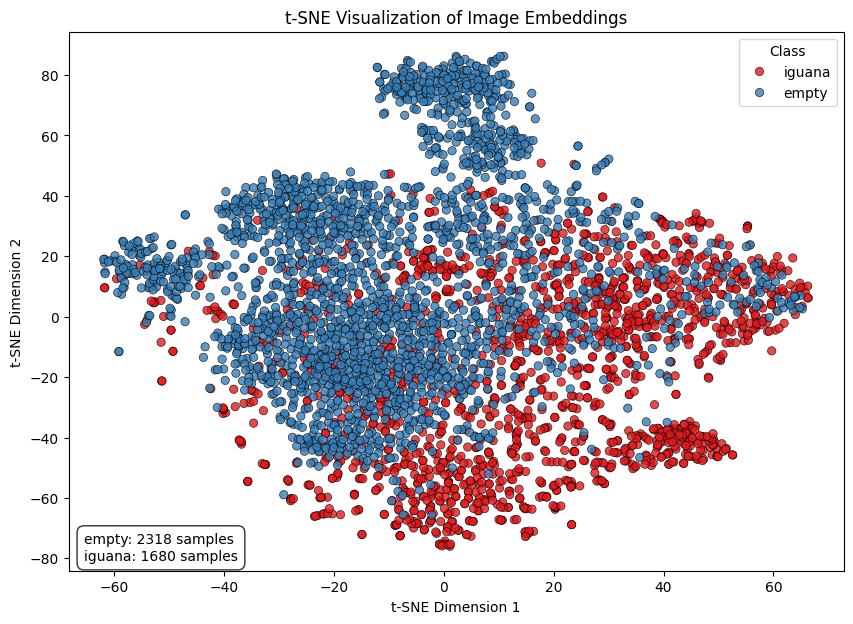

In [33]:
from active_learning.feature_extraction.embedding_clustering import get_tsn_embeddings

df_tsne_embeddings = get_tsn_embeddings(embedding_save_path)

df_tsne_embeddings.to_csv(tsne_embedding_save_path)

In [34]:
df_tsne_embeddings

,X,Y,class,file_name
0,30.442297,-41.559265,iguana,Gen_GES01to09_04122021_centered_171694.2524274...
1,44.772789,-34.726147,iguana,Gen_GES01to09_04122021_centered_171694.4546389...
2,44.352783,-43.795719,iguana,Gen_GES01to09_04122021_centered_171692.8369472...
3,45.091152,-46.284756,iguana,Gen_GES01to09_04122021_centered_171693.0199004...
4,40.494900,-40.134731,iguana,Gen_GES01to09_04122021_centered_171693.5639455...
...,...,...,...,...
3993,50.756233,23.827827,empty,Scris_SRLS04_10012020_empty_217535_9909515_217...
3994,24.263287,43.581707,empty,Scris_SRLS04_10012020_empty_217599_9909551_217...
3995,-11.707089,72.186249,empty,Scris_SRLS04_10012020_empty_217813_9909484_217...
3996,49.795284,16.575771,empty,Scris_SRLS04_10012020_empty_217594_9909543_217...


In [35]:
from active_learning.feature_extraction.embedding_clustering import visualize_clusters, perform_clustering

perform_clustering(df_tsne_embeddings, n_clusters=2)

df_tsne_embeddings

Applying K-means clustering with 2 clusters...


,X,Y,class,file_name,cluster,predicted_class,is_correct,cluster_confidence
0,30.442297,-41.559265,iguana,Gen_GES01to09_04122021_centered_171694.2524274...,1,iguana,True,0.590472
1,44.772789,-34.726147,iguana,Gen_GES01to09_04122021_centered_171694.4546389...,1,iguana,True,0.590472
2,44.352783,-43.795719,iguana,Gen_GES01to09_04122021_centered_171692.8369472...,1,iguana,True,0.590472
3,45.091152,-46.284756,iguana,Gen_GES01to09_04122021_centered_171693.0199004...,1,iguana,True,0.590472
4,40.494900,-40.134731,iguana,Gen_GES01to09_04122021_centered_171693.5639455...,1,iguana,True,0.590472
...,...,...,...,...,...,...,...,...
3993,50.756233,23.827827,empty,Scris_SRLS04_10012020_empty_217535_9909515_217...,0,empty,True,0.807602
3994,24.263287,43.581707,empty,Scris_SRLS04_10012020_empty_217599_9909551_217...,0,empty,True,0.807602
3995,-11.707089,72.186249,empty,Scris_SRLS04_10012020_empty_217813_9909484_217...,0,empty,True,0.807602
3996,49.795284,16.575771,empty,Scris_SRLS04_10012020_empty_217594_9909543_217...,1,iguana,False,0.590472


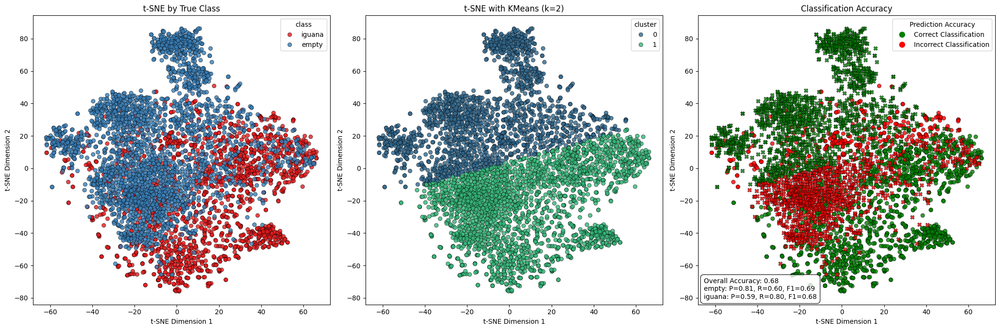

In [36]:

visualize_clusters(df_tsne_embeddings)

In [37]:
from active_learning.feature_extraction.embedding_clustering import get_misclassified_items

### What is the error now?
df_misclassified = get_misclassified_items(df_tsne_embeddings)

df_misclassified

,true_class,predicted_class,cluster,cluster_confidence,X,Y,file_name
2314,empty,iguana,1,0.590472,-14.216584,-27.554399,Gen_GES01to09_04122021_empty_171675_33240_1716...
2848,empty,iguana,1,0.590472,-9.180337,-23.658243,Gen_GES01to09_04122021_empty_171603_33214_1716...
2842,empty,iguana,1,0.590472,-4.509742,-5.126073,Gen_GES01to09_04122021_empty_171270_33301_1712...
2839,empty,iguana,1,0.590472,-17.890144,-3.957609,Gen_GES01to09_04122021_empty_171742_33261_1717...
2838,empty,iguana,1,0.590472,-11.886982,-42.198814,Gen_GES01to09_04122021_empty_171476_33230_1714...
...,...,...,...,...,...,...,...
1278,iguana,empty,0,0.807602,2.070312,15.890166,Gen_GES01to09_04122021_centered_171239.6714262...
1279,iguana,empty,0,0.807602,0.503091,13.274284,Gen_GES01to09_04122021_centered_171239.4692148...
1280,iguana,empty,0,0.807602,0.565486,14.673119,Gen_GES01to09_04122021_centered_171239.4451420...
1282,iguana,empty,0,0.807602,-0.911220,17.215427,Gen_GES01to09_04122021_centered_171239.9843725...


## Display those incorrect images


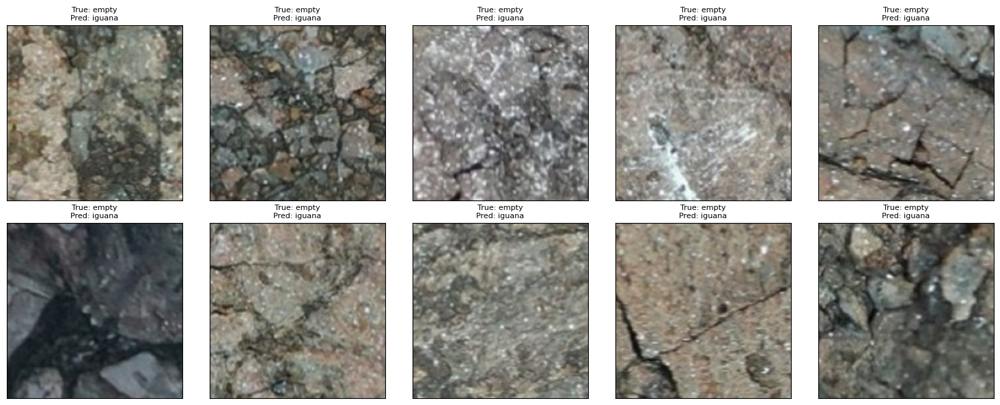

In [38]:

from active_learning.feature_extraction.embedding_clustering import display_misclassified_grid

display_misclassified_grid(df_misclassified[df_misclassified.true_class == "empty"], image_dir=image_root_dir, cols=5, rows=2, figsize=(15, 6))

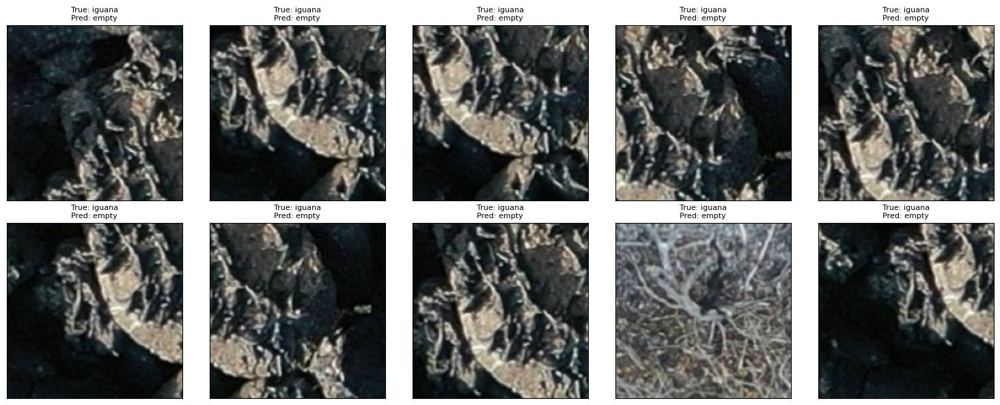

In [39]:
display_misclassified_grid(df_misclassified[df_misclassified.true_class == "iguana"], image_dir=image_root_dir, cols=5, rows=2, figsize=(15, 6))


Diagnosis:
- There are label errors in the data whith images labeled as empty, but they contain animals
- a pretrained resnet model can't seperate occupied from empty images

### Load a fine tuned weight which was fine tuned Orthomosaic data

Using device: mps
Loading checkpoint from: /Users/christian/PycharmProjects/hnee/pytorch-image-models/output/iguanas_empty_resnet34.a1_in1k/model_best.pth.tar


/Users/christian/PycharmProjects/hnee/active_learning/active_learning/feature_extraction/timm_feature_extraction.py:61: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpo

Detected checkpoint dictionary with state_dict
Model loaded successfully. Input size: (3, 224, 224)


Extracting features: 100%|██████████| 3998/3998 [00:53<00:00, 74.76it/s]


Saved embeddings to embeddings_with_labels_ft.csv
[6.44053282e-01 1.31579644e-01 7.60679390e-02 1.98283492e-02
 1.40462864e-02 1.07381905e-02 8.39386462e-03 7.34610765e-03
 5.50506055e-03 4.40095701e-03 4.29877325e-03 3.61706694e-03
 2.91508955e-03 2.63459031e-03 2.56252134e-03 2.42110482e-03
 2.03997885e-03 1.89355540e-03 1.78159123e-03 1.50365966e-03
 1.40744450e-03 1.37286474e-03 1.25136918e-03 1.21286308e-03
 1.13667497e-03 1.11615831e-03 1.02212764e-03 9.88210449e-04
 8.75513140e-04 8.68810699e-04 8.43982826e-04 7.96971496e-04
 7.72085838e-04 7.68832641e-04 7.13327945e-04 6.96885216e-04
 6.35441307e-04 6.22591855e-04 5.93407894e-04 5.76391266e-04
 5.51036630e-04 5.42764666e-04 5.27145100e-04 5.11834156e-04
 4.92891784e-04 4.87185037e-04 4.60567673e-04 4.53063407e-04
 4.43249839e-04 4.20276673e-04 4.14713970e-04 4.11555005e-04
 4.07999777e-04 3.95380334e-04 3.83485198e-04 3.75586739e-04
 3.62264689e-04 3.55882915e-04 3.51701606e-04 3.39030121e-04
 3.33056319e-04 3.28119288e-04 3.20

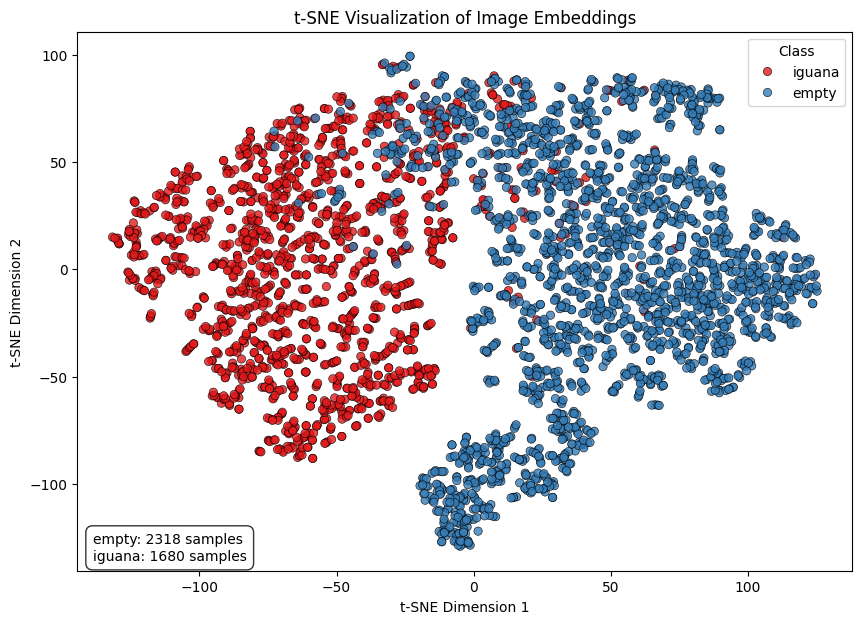

In [40]:
from pathlib import Path
from active_learning.feature_extraction.timm_feature_extraction import FeatureExtractor


model_name = "timm/resnet34.a1_in1k"
model_path = "/Users/christian/PycharmProjects/hnee/pytorch-image-models/output/iguanas_empty_resnet34.a1_in1k/model_best.pth.tar"
extractor = FeatureExtractor(model_name=model_name, model_path=model_path)

# image_root_dir = "/Users/christian/data/WAID-main/WAID/images/train_sample"  # This should contain subfolders (ClassA, ClassB, ...)
embedding_ft_save_path = "embeddings_with_labels_ft.csv"
tsne_embedding_ft_save_path = "tsne_embeddings_with_labels.csv"

images_list = [i for i in image_root_dir.rglob("*.jpg") if not str(i).startswith(".")]
class_labels = [x.parent.stem for x in images_list]

df_features_ft = extractor.extract_from_image_list(images_list, class_labels=class_labels, save_path=embedding_ft_save_path)

df_tsne_embeddings_ft_iguanas_points = get_tsn_embeddings(embedding_ft_save_path, perplexity=5)


Applying K-means clustering with 2 clusters...


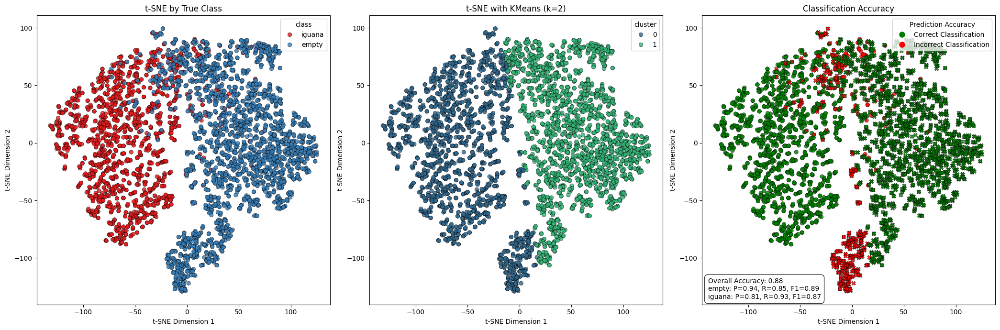

In [41]:
perform_clustering(df_tsne_embeddings_ft_iguanas_points, n_clusters=2)
visualize_clusters(df_tsne_embeddings_ft_iguanas_points)

In [42]:
### What is the error now?
df_misclassified = get_misclassified_items(df_tsne_embeddings_ft_iguanas_points)

df_misclassified

,true_class,predicted_class,cluster,cluster_confidence,X,Y,file_name
2608,empty,iguana,0,0.813118,-23.233078,47.395943,Gen_GES01to09_04122021_empty_172095_33387_1720...
3221,empty,iguana,0,0.813118,3.716532,-112.037483,Gen_GES01to09_04122021_empty_172183_33412_1721...
3217,empty,iguana,0,0.813118,-15.975748,29.308807,Gen_GES01to09_04122021_empty_172168_33365_1721...
3216,empty,iguana,0,0.813118,-6.593168,-106.858856,Gen_GES01to09_04122021_empty_172050_33247_1720...
3209,empty,iguana,0,0.813118,5.770688,-114.666656,Gen_GES01to09_04122021_empty_172109_33245_1721...
...,...,...,...,...,...,...,...
1327,iguana,empty,1,0.943187,-2.735159,87.026192,Gen_GES01to09_04122021_centered_172168.5490464...
1334,iguana,empty,1,0.943187,-7.935668,75.463234,Gen_GES01to09_04122021_centered_171998.0895964...
1335,iguana,empty,1,0.943187,31.224274,21.463205,Gen_GES01to09_04122021_centered_172192.2029731...
1128,iguana,empty,1,0.943187,-6.021995,76.923599,Gen_GES01to09_04122021_centered_172059.1333859...


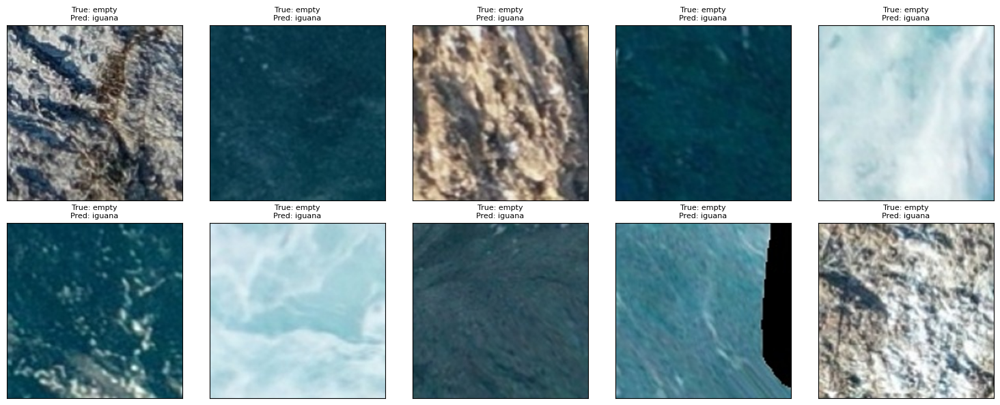

In [43]:
from active_learning.feature_extraction.embedding_clustering import display_misclassified_grid

display_misclassified_grid(df_misclassified[df_misclassified.true_class == "empty"], image_dir=image_root_dir, cols=5, rows=2, figsize=(15, 6))

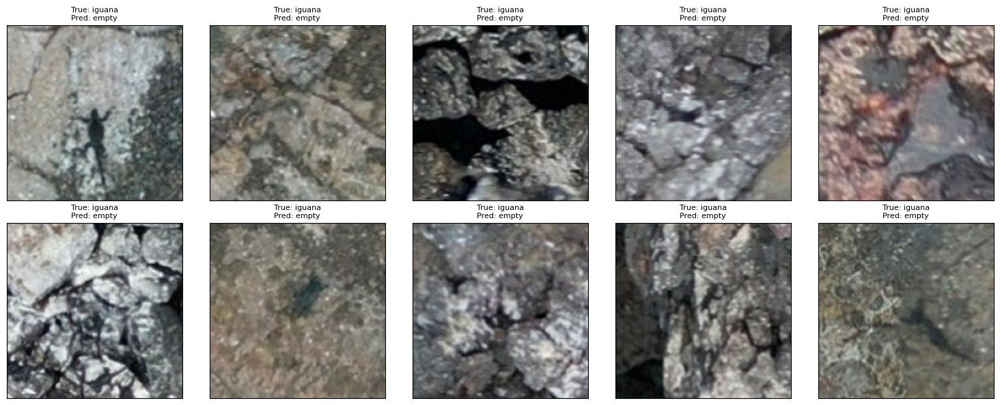

In [44]:
from active_learning.feature_extraction.embedding_clustering import display_misclassified_grid

display_misclassified_grid(df_misclassified[df_misclassified.true_class == "iguana"], image_dir=image_root_dir, cols=5, rows=2, figsize=(15, 6))

In [45]:
from matplotlib import pyplot as plt
from active_learning.feature_extraction.timm_logit_extraction import LogitExtractor

model_path = "/Users/christian/PycharmProjects/hnee/pytorch-image-models/output/iguanas_empty_resnet34.a1_in1k/model_best.pth.tar"

# Initialize with a custom checkpoint
extractor2 = LogitExtractor(
    model_name='resnet34',  # Base architecture
    checkpoint_path=model_path,  # Your trained weights
    num_classes=2,  # Number of classes in your model
)


# image_root_dir = "/Users/christian/data/WAID-main/WAID/images/train_sample"  # This should contain subfolders (ClassA, ClassB, ...)
embedding_save_path = "embeddings_with_labels.csv"
tsne_embedding_save_path = "tsne_embeddings_with_labels.csv"

image_root_dir = Path(
    "/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val")

images_list = [i for i in image_root_dir.rglob("*.jpg") if not str(i).startswith(".")]
# randomply sample 100 images
# images_list = random.sample(images_list, 500)
class_labels = [x.parent.stem for x in images_list]

Using device: mps
Loading checkpoint from: /Users/christian/PycharmProjects/hnee/pytorch-image-models/output/iguanas_empty_resnet34.a1_in1k/model_best.pth.tar


/Users/christian/PycharmProjects/hnee/active_learning/active_learning/feature_extraction/timm_logit_extraction.py:75: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoin

Model loaded successfully. Input size: (3, 224, 224)
Output shape: torch.Size([1, 2]) (number of classes: 2)


In [46]:

results_df = extractor2.extract_from_image_list(
    image_paths=images_list,
    class_labels=class_labels,  # Optional
class_mapping=["empty", "iguana"],  # Maps index 0 to "empty" and index 1 to "iguana"

    save_path='logits_results.csv'
)

Extracting logits: 100%|██████████| 3998/3998 [00:53<00:00, 75.18it/s] 

Saved logits to logits_results.csv


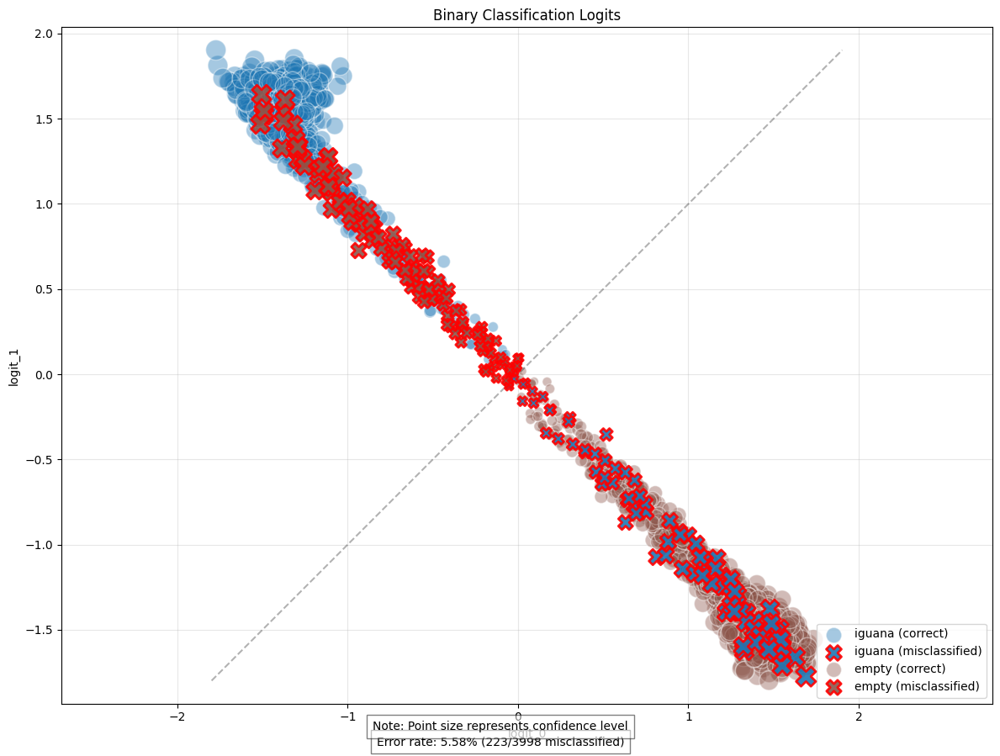

In [50]:

fig = extractor2.visualize_binary_logits(dataframe=results_df)
plt.show()


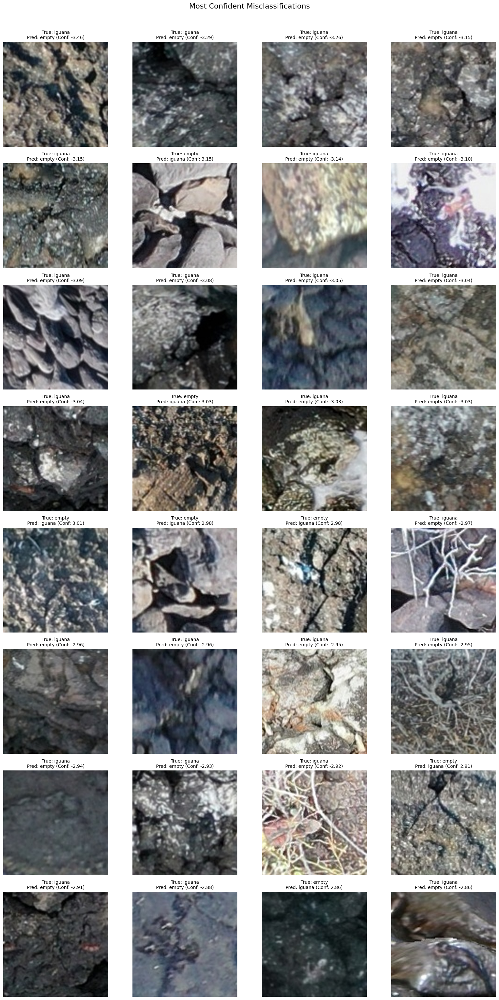

In [48]:

results_df

fig_2 = extractor2.visualize_confident_errors(dataframe=results_df, image_dir=image_root_dir, n_images=32)

plt.show()

In [ ]:
# TODO label these in fiftyOne

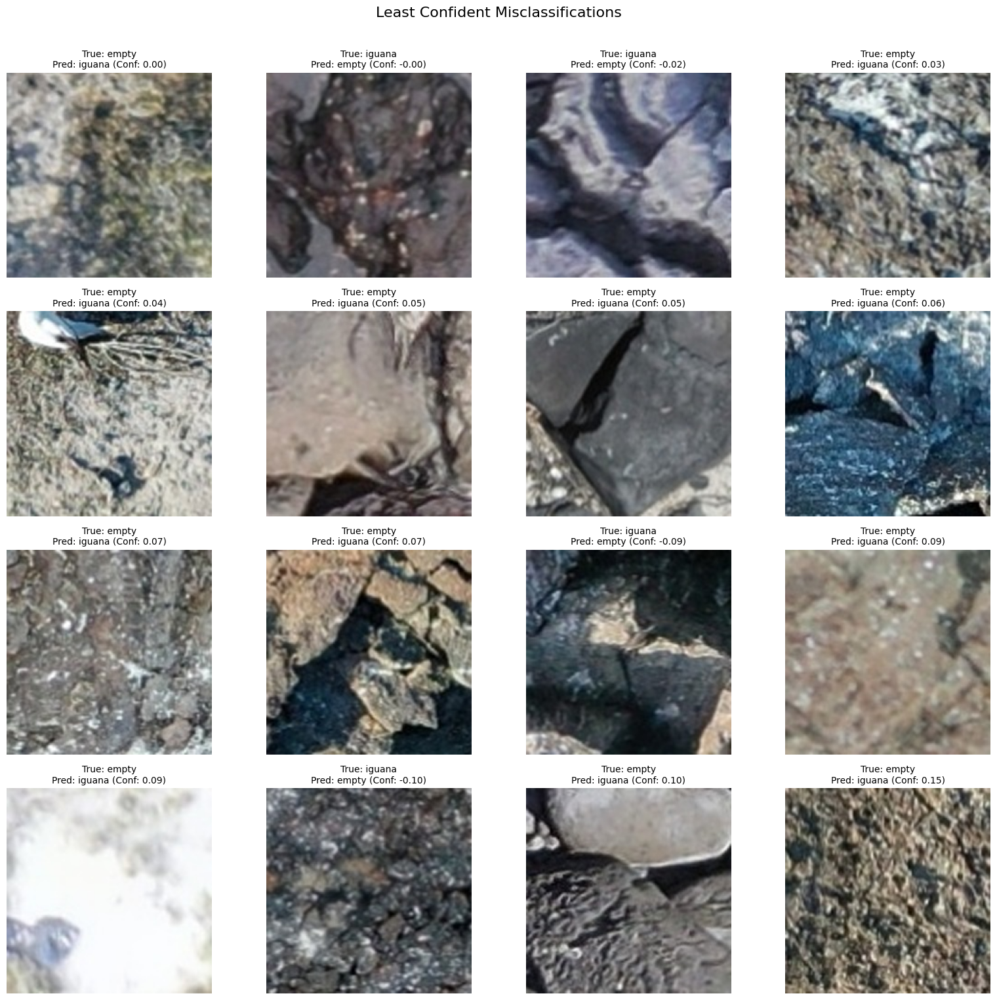

In [51]:
fig_3 = extractor2.visualize_confident_errors(dataframe=results_df, image_dir=image_root_dir, n_images=16, sort_order_ascending=True, title="Least Confident Misclassifications")

plt.show()

In [ ]:
## Grad CAM

Loading checkpoint from: /Users/christian/PycharmProjects/hnee/pytorch-image-models/output/iguanas_empty_resnet34.a1_in1k/model_best.pth.tar


/Users/christian/PycharmProjects/hnee/active_learning/active_learning/feature_extraction/GradCamVisualiser.py:84: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = 

Model loaded successfully. Input size: (3, 224, 224)
Output shape: torch.Size([1, 2]) (number of classes: 2)
Saved visualization to cam_visualization.png


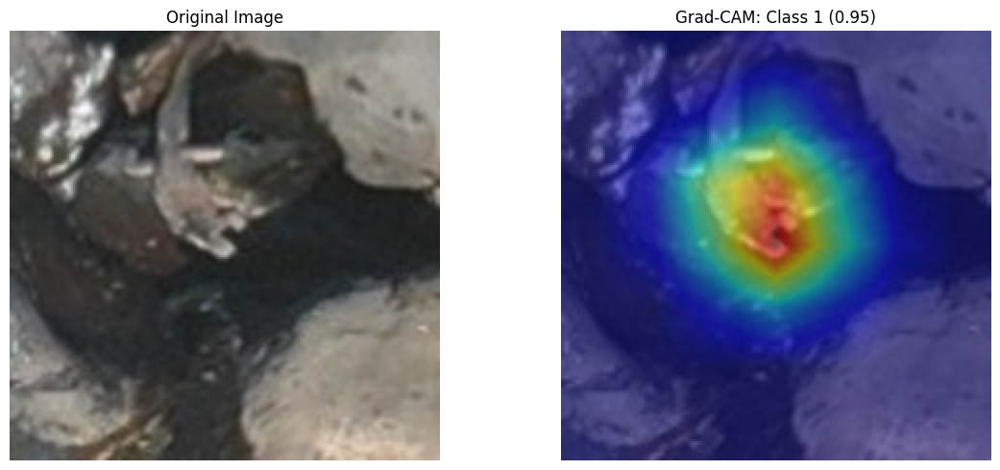

In [52]:
from active_learning.feature_extraction.GradCamVisualiser import GradCAMVisualizer

cam_vis = GradCAMVisualizer(model_name='resnet34',
    checkpoint_path=model_path,
    num_classes=2,
)

empty_image_path = "/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/empty/Flo_FLPC04_22012021_empty_117322_9864145_117322_9864146.jpg"
iguana_image_path = "/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/iguana/Scris_SRL12_10012021_centered_207975.4858857841_9898061.550476288.jpg"
# Visualize CAM for a single image
fig = cam_vis.visualize(
    # image_path=empty_image_path,
    image_path=iguana_image_path,
    save_path='cam_visualization.png'
)
plt.show()

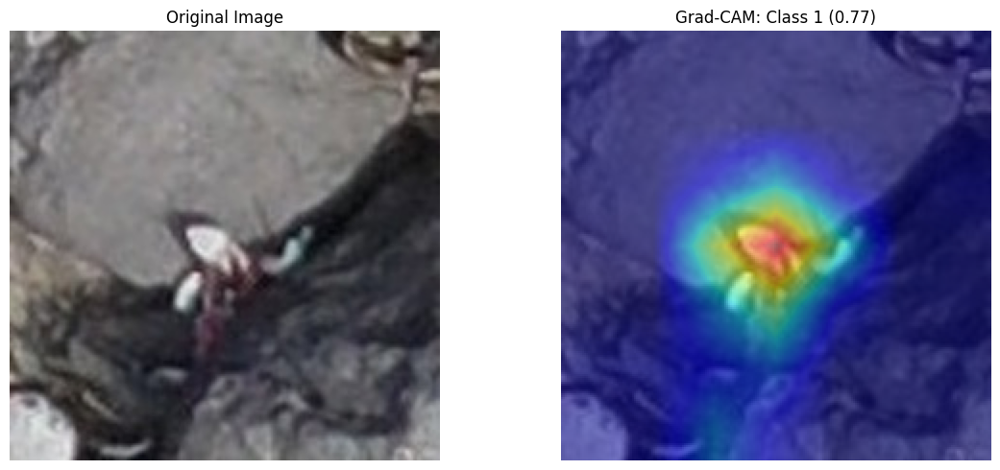

In [55]:
iguana_image_path = "/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/iguana/Esp_EPCN03_26012021_centered_207889.57336097755_9846696.638274768.jpg"

fig = cam_vis.visualize(
    # image_path=empty_image_path,
    image_path=iguana_image_path,
)
plt.show()

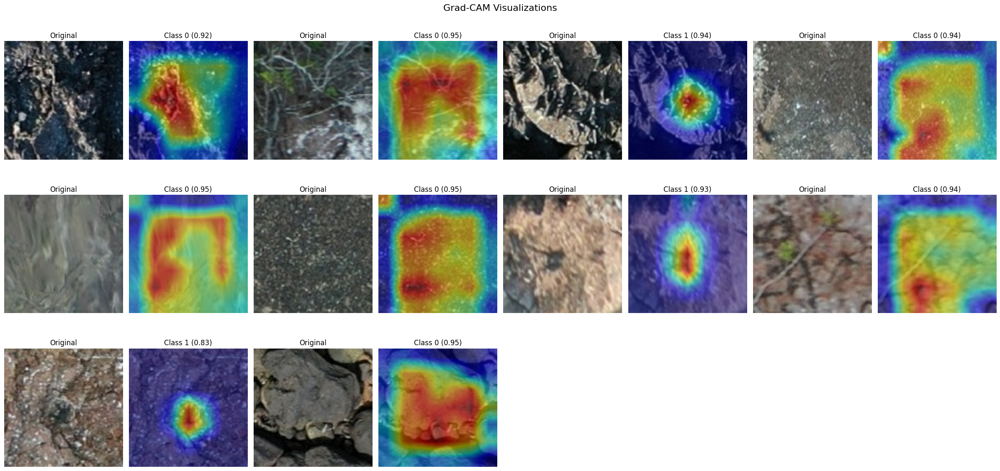

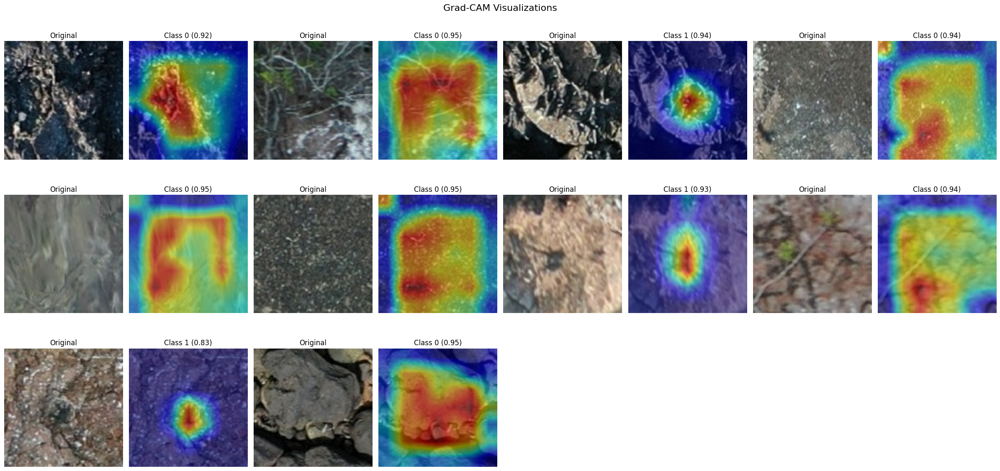

In [64]:
images_list
import random
cam_vis.visualize_batch(random.sample(images_list, 10))

In [58]:
images_list

[PosixPath('/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/iguana/Gen_GES01to09_04122021_centered_171694.25242745873_33172.543485587354.jpg'),
 PosixPath('/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/iguana/Gen_GES01to09_04122021_centered_171694.45463892317_33172.24498294937.jpg'),
 PosixPath('/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/iguana/Gen_GES01to09_04122021_centered_171692.83694720766_33171.84537457918.jpg'),
 PosixPath('/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/iguana/Gen_GES01to09_04122021_centered_171693.01990043742_33171.68649414283.jpg'),
 PosixPath('/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/iguana/Gen_GES01to09_04122021_centered_171693.5639455679_33171.9031492833.jpg'),
 PosixPath('/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/iguana/Gen_GES01to09_04122021_centered_171694.45463892317_33171.35910415279.jpg'),
 PosixPath('/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/iguana/Gen_GES01to09_04122021_centered_171694.51722818599_33171.513170030456

[PosixPath('/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/iguana/Gen_GES01to09_04122021_centered_171620.73893101828_33288.362509123166.jpg'),
 PosixPath('/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/empty/Gen_GES01to09_04122021_empty_172060_33338_172061_33339.jpg'),
 PosixPath('/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/iguana/Gen_GES01to09_04122021_centered_171638.4613215086_33177.63608502804.jpg'),
 PosixPath('/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/iguana/Gen_GES01to09_04122021_centered_171785.8590354079_33227.567873067994.jpg'),
 PosixPath('/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/iguana/Gen_GES01to09_04122021_centered_171691.93181017638_33173.14049086331.jpg'),
 PosixPath('/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/iguana/Gen_GES01to09_04122021_centered_171998.08959645283_33340.2141024357.jpg'),
 PosixPath('/Volumes/2TB/DD_MS_COG_ALL_TILES/herdnet_112/val/iguana/Gen_GES01to09_04122021_centered_172097.1539557926_33269.88543656019.jpg'),
 PosixPat

In [62]:
image_path_empty_1[10:]

TypeError: 'PosixPath' object is not subscriptable